# Movie Data - Initial Analysis

**The Problem**

An investor is looking to to fund a profitable movie. How can data be used to aid the decision making process of what type of film should be produced?

**Method**

This document evaluates the data and tries to investigate what factors contribute to a movie beign profitable.

This covers the following: 

*   Data clean up and formatting
*   Frequency of genres in data set
*   Evaluation of movie finance data
*   Plot of normalised review score 
*   Identified top 20 directors 
*   Identified top 20 actors 
*   Comparitive plot of all numeric variables of movies



In [1]:
# Importing packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
import json
import datetime
import requests
import os.path
from os import path


# Import and Clean Data

In [2]:
# from google.colab import drive
# drive.mount('/content/drive')

In [3]:
# Importing dataset into colab
# As we are working with colab, we will need to use the following code to import the dataset into this notebook
#from google.colab import files 
#uploaded = files.upload()

In [4]:
# Create Dataframes for each csv

movies = pd.read_csv('tmdb_5000_movies.csv')
print(movies.shape)
credits = pd.read_csv('tmdb_5000_credits.csv')
credits = credits.drop('title',1)
print(credits.shape)

(4803, 20)
(4803, 3)


In [5]:
# movies.head()

In [6]:
# credits.head()

In [7]:
# Change credit dataframe's heading to match movies dataframe headings

credits.columns = ['id','cast','crew']

# Merge data frames using movies unique id

movies = movies.merge(credits, on='id')

# movies.head(3)
# movies.shape
# movies.dtypes

## Rescrapping Budget and Revenue from Tmdb

From a brief inspection the budget and revenue columns are missing significant amounts of data or have numbers which appear to be orders of magnitude different to the rest of the data. 

A scrapper was created to retrieve the values from the original source.

In [8]:
# Function to perform api call

def get_revenue(movie_id):

    with open('themoviedb_apikey.txt') as f:
        contents = f.read()

    url = 'https://api.themoviedb.org/3/movie/' + str(movie_id) + '?api_key=' + contents

    r = requests.get(url)
    r = r.json()
    return r

In [9]:
# Rescrap data through api

if path.exists('tmdb_5000_movies_api.csv') == bool(True):

    movies = pd.read_csv('tmdb_5000_movies_api.csv')

else:

    for i in range(movies.shape[0]): 
        try:
          response = get_revenue(movies.iloc[i]['id'])
          movies.at[i,'api revenue'] = response['revenue']
          movies.at[i,'api budget'] = response['budget']
          print(movies.iloc[i]['id'])
        except:
          pass

    movies.to_csv('tmdb_5000_movies_api.csv', index = False)


In [10]:
# Clean budget and revenue data 

# Remove entries with budget and revenue recorded in incorrect magnitude
movies = movies.loc[(movies['api budget']> 100)]
movies = movies.loc[(movies['api revenue']> 100)]

movies['original budget'] = movies['budget']
movies['original revenue'] = movies['revenue']

movies['budget'] = movies['api budget']
movies['revenue'] = movies['api revenue']

# Set release date to correct data types

movies['budget'] = movies['budget'].astype('float')/1000000 # Stored in Millions
movies['revenue'] = movies['revenue'].astype('float')/1000000 # Stored in Millions

# Add profit coloumn to movies DataFrame in terms of millions of dollars

movies['profit'] = movies['revenue']- movies['budget']

movies.reset_index(drop=True, inplace=True)

In [11]:
# Set release date to correct data type

movies['release_date'] = pd.to_datetime(movies['release_date'])

## Cleaning Text Fields in DataFrame 

In [12]:
# Extract text from columns with data stored in json format

features = ['genres', 'keywords', 'cast', 'crew']

for feature in features:
  
  movies[feature] = movies[feature].apply(json.loads)

# movies.head()  

# Create functions to extract director, cast members, and keywords

# Find Director 
def get_director(x):
    for i in x:
        if i['job'] == 'Director':
            return i['name']
    return np.nan

# Get first 3 Cast members - it is assumed that this is order starting with lead rather than appearance

def get_cast(x):
  if isinstance(x, list):
  
    names = [i['name'] for i in x]

    names = names[:3]

  return names
  
# Get Genres

def find_genres(x):

    if isinstance(x, list):

      genres = [i['name'] for i in x]

    return genres

# Get Keywords 

def find_keywords(x): 

    if isinstance(x, list):

      keywords = [i['name'] for i in x]

    return keywords     

In [13]:
# Apply functions to relevent columns

movies['director'] = movies['crew'].apply(get_director)
movies['cast'] = movies['cast'].apply(get_cast)
movies['genres'] = movies['genres'].apply(find_genres)
movies['keywords'] = movies['keywords'].apply(find_keywords)

# Drop crew column

movies = movies.drop('crew',1)

In [14]:
# Identify Main Genre & Lead Actor for Movie - This has been taken as the first value in the genres list

for idx, row in movies.iterrows(): # This is not the most efficent method
    try:      
      movies.at[idx,'primary genre'] = movies.iloc[idx]['genres'][0]
      movies.at[idx,'lead actor'] = movies.iloc[idx]['cast'][0]
    except:
      pass


In [15]:
# Identify fields missing data

movies.isnull().sum()

budget                     0
genres                     0
homepage                2075
id                         0
keywords                   0
original_language          0
original_title             0
overview                   0
popularity                 0
production_companies       0
production_countries       0
release_date               0
revenue                    0
runtime                    0
spoken_languages           0
status                     0
tagline                  295
title                      0
vote_average               0
vote_count                 0
cast                       0
api revenue                0
api budget                 0
original budget            0
original revenue           0
profit                     0
director                   2
primary genre              1
lead actor                 3
dtype: int64

In [16]:
# Keep completed fields

movies = movies[movies['director'].notnull()]
movies = movies[movies['runtime'].notnull()]
movies = movies[movies['overview'].notnull()]
movies = movies[movies['primary genre'].notnull()]
movies = movies[movies['lead actor'].notnull()]
movies = movies[movies['tagline'].notnull()]
movies = movies.drop('homepage',1)
movies.isnull().sum()

budget                  0
genres                  0
id                      0
keywords                0
original_language       0
original_title          0
overview                0
popularity              0
production_companies    0
production_countries    0
release_date            0
revenue                 0
runtime                 0
spoken_languages        0
status                  0
tagline                 0
title                   0
vote_average            0
vote_count              0
cast                    0
api revenue             0
api budget              0
original budget         0
original revenue        0
profit                  0
director                0
primary genre           0
lead actor              0
dtype: int64

In [17]:
# Drop Movies where runtime = zero 

movies['runtime'] = movies['runtime'].replace(0,np.NaN)
movies = movies.dropna(subset=['runtime'])

# Analysis of movies database 

This section looks at the distribution of features within the data set which covers the following:

*   Distribution of genres
*   Distribution of movie lengths
*   Distribution of release year
*   Distribution of popularity frequency
*   Distribution of Original Film Studio 
*   Identify the top directors and actors




## Distribution of Genres

From inspecting the data it is visible that the movies have been assigned the genres that are appropiate. It has been assumed that these are order in order of significance i.e. the most suiatble first. This information is used in later analysis. 

For an initial observation it is of interst to see the frequency of the genres ascribed to each film. 


In [18]:
genres_list = movies['genres'].tolist()

genres_all = []

for sublist in genres_list:
  for item in sublist:
    genres_all.append(item)

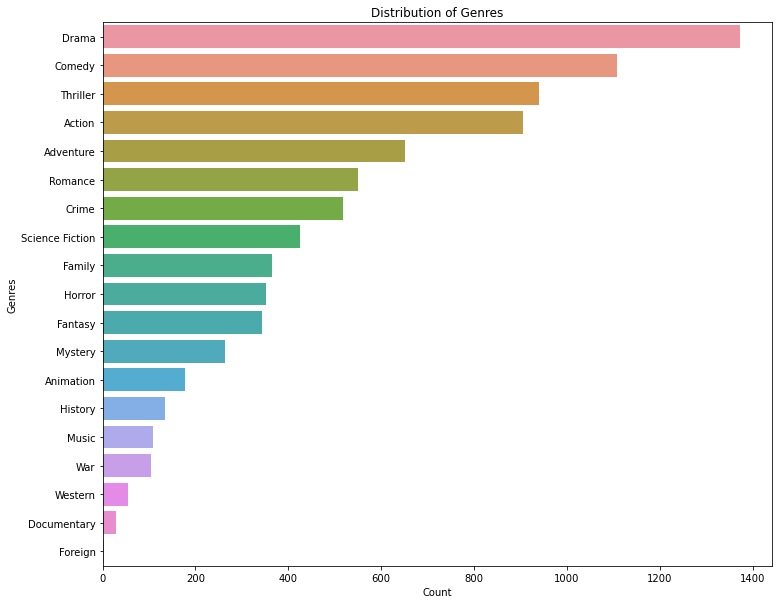

In [19]:
from collections import Counter
genres_counter = Counter(genres_all)
genres_keys = pd.DataFrame.from_dict(genres_counter.keys())
genres_values = pd.DataFrame.from_dict(genres_counter.values())
genres_df = pd.concat([genres_keys, genres_values], axis=1)
genres_df.columns = ['Genre Keys', 'Genre Values']
top_genres = genres_df.nlargest(columns="Genre Values", n = 20) 


plot_title = 'Distribution of Genres'
plt.figure(figsize=(12,10)) 
sns_plot = sns.barplot(data=top_genres, x= "Genre Values", y = "Genre Keys") 
sns_plot.set(ylabel = 'Genres') 
sns_plot.set(xlabel = 'Count') 
sns_plot.set(title = plot_title)
plt.show()

sns_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

Drama appears to be the genre which is applied to roughly half of the films within the database. Genres such as action and adventure are close in ranking which would be expected as the plots for these types of movies tend to be similar.  

## Distribution of Movie Lengths 


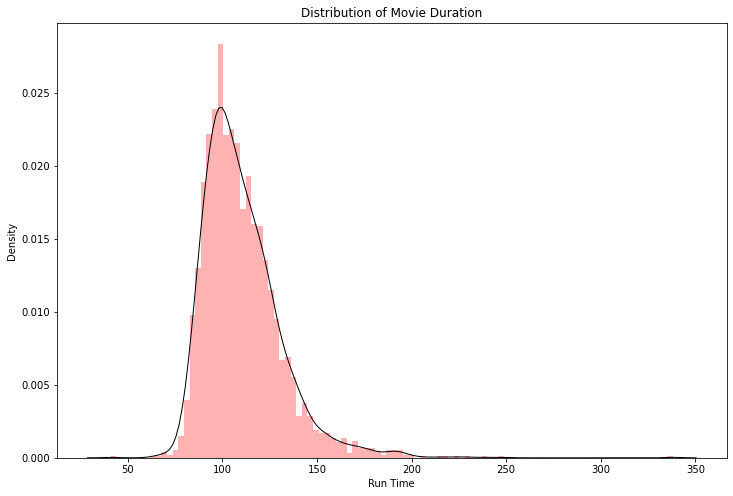

In [20]:
# Distribution of Video Duration
plt.figure(figsize=(12,8))

plot_title = 'Distribution of Movie Duration'
sns_plot = sns.distplot(movies['runtime'], bins=100, kde_kws={'linewidth':1, 'color':'black'}, hist_kws={'alpha':.3, 'color':'red'})
sns_plot.set(xlabel = 'Run Time') 
sns_plot.set(title = plot_title)

sns_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

The movie duration is centred around 100 minutes with the majority of those falling within +/- 40 minutes of that centre. 

## Distribution of Release Year

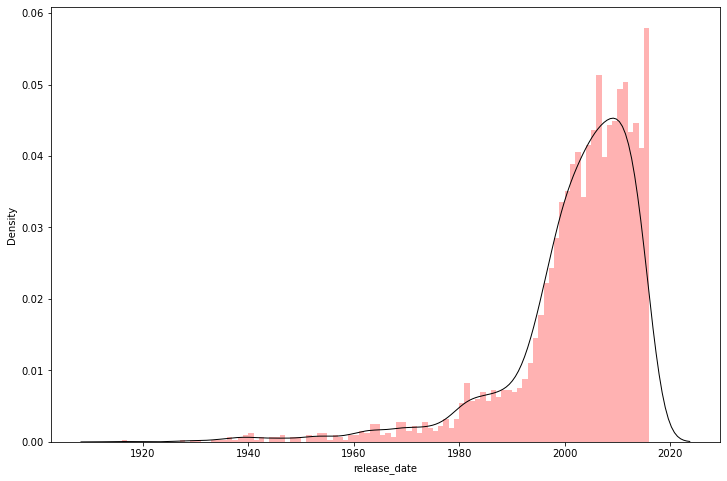

In [21]:
# Distribution of Movie Releases Per Year

plt.figure(figsize=(12,8))
plot_title = 'Distribution of Movie Releases Per Year'
sns.distplot(pd.DatetimeIndex(movies['release_date']).year, bins=100, kde_kws={'linewidth':1, 'color':'black'}, hist_kws={'alpha':.3, 'color':'red'})
sns_plot.set(xlabel = 'Release Date') 
sns_plot.set(title = plot_title)

sns_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

It is visible that this dataset is heavily skewed towards films realsed from the 1995 onwards. For future analysis films released from the year 2000 onwards will be used where the releases per year are more consistent and are more likely to reflect current market conditions. 

## Distribution of Popularity Frequency 

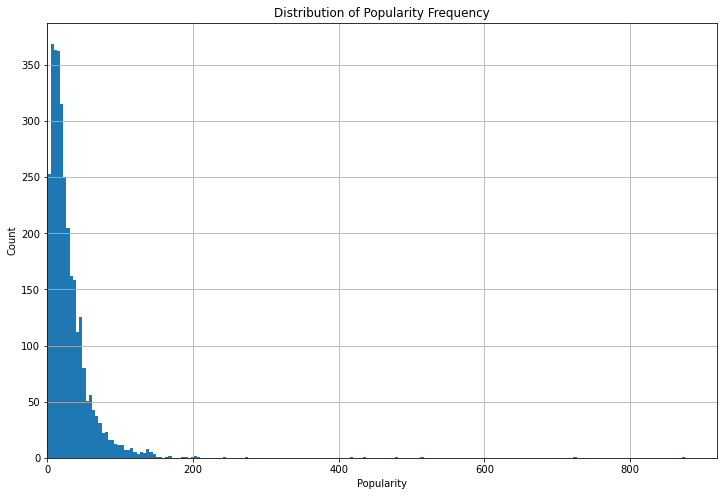

In [22]:
plot_title = 'Distribution of Popularity Frequency'
popularity_plot = movies['popularity'].plot.hist(grid=True, bins = 200, figsize=(12,8))
popularity_plot.set_xlabel('Popularity')
popularity_plot.set_ylabel('Count')
popularity_plot.set_xbound(lower = 0)
popularity_plot.set_title(plot_title)

popularity_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

The popularity distribution is heavily skewed towards zero. A concern with this data field is whether the value is zero because it hasn't be filled or the film really isn't popular. Due to the shape of the skew of the data it is fair to assume that this is a calculated field and that all values are true. Films popularity tends to be quite fleeting hence the majority of the films are towards the lower end of the scale. One could hypothesize the highly popular films are those that are currently in theatres or recently released to dvd.

In [23]:
top_popularity = movies.sort_values('popularity', ascending=False)[['title','popularity', 'release_date']]

top_popularity.head(10)

,title,popularity,release_date
530,Minions,875.581305,2015-06-17
94,Interstellar,724.247784,2014-11-05
757,Deadpool,514.569956,2016-02-09
93,Guardians of the Galaxy,481.098624,2014-07-30
126,Mad Max: Fury Road,434.278564,2015-05-13
28,Jurassic World,418.708552,2015-06-09
197,Pirates of the Caribbean: The Curse of the Bla...,271.972889,2003-07-09
82,Dawn of the Planet of the Apes,243.791743,2014-06-26
198,The Hunger Games: Mockingjay - Part 1,206.227151,2014-11-18
87,Big Hero 6,203.734590,2014-10-24


## Identify the Top Directors and Actors

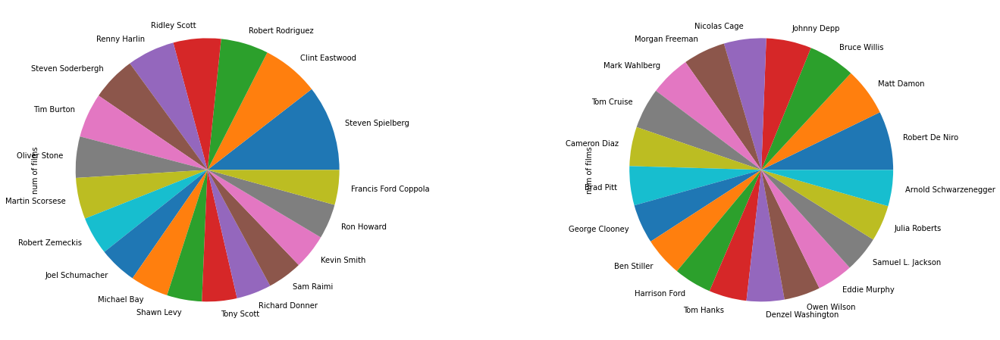

In [24]:
fig, (ax1, ax2) = plt.subplots(1,2)

# Collate all directors into single list and count frequency of each director
# Identify the top 20 directors

directors_all = movies['director'].tolist()
directors_counter = Counter(directors_all)
directors_keys = pd.DataFrame.from_dict(directors_counter.keys())
directors_values = pd.DataFrame.from_dict(directors_counter.values())
directors_df = pd.concat([directors_keys, directors_values], axis=1)
directors_df.columns = ['directors', 'num of films']
directors_df = directors_df.sort_values('num of films', ascending=False)
directors_top_20 = directors_df.iloc[0:19]

# Plot Pie chart

directors_top_20.set_index('directors',inplace=True)
directors_pie = directors_top_20['num of films'].plot.pie(figsize=(24,8),ax=ax1)

# List of actors has been reduced to three in pre-prossesing to select only the headliners 

# Collate all actors into single list and count frequency of each director
# Identify the top 20 actors

cast_list = movies['cast'].tolist()
cast_all = []
for sublist in cast_list:
  for item in sublist:
    cast_all.append(item)

cast_counter = Counter(cast_all)
cast_keys = pd.DataFrame.from_dict(cast_counter.keys())
cast_values = pd.DataFrame.from_dict(cast_counter.values())
cast_df = pd.concat([cast_keys, cast_values], axis=1)
cast_df.columns = ['cast', 'num of films']
cast_df = cast_df.sort_values('num of films', ascending=False)

# Plot Pie chart
plot_title = 'Actors Pie Chart'
cast_df.set_index('cast',inplace=True)
cast_pie = cast_df['num of films'].head(20).plot.pie(figsize=(24,8),ax=ax2)
cast_pie.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

# Calculate Imdb Rating

An issue with the movie database is the average vote and vote count. This can be heavily skewed and does not give a good representation of the quality of the film. 

Imdb.com have developed a equation and method to reduce the effect of this skew. The equation is as follows:

$ WR = (\frac{v}{v+m}R)+(\frac{m}{v+m}C)$

This has was calculated for future analyis and use in learning algorithms. However, implementing this method means that only approximately 500 films are suitable for an Imdb rating. 


In [25]:
# Plot histogram of Weighted Rating of Viewers Score 

mean_score = movies['vote_average'].mean()

min_votes = movies['vote_count'].quantile(0.9)

# Find films which meet the min votes criteria 

weighted_movies = movies.copy().loc[movies['vote_count'] > min_votes]

# Function to calcualte weighted ranking 

def calc_weighted_ranking(input_df,m = min_votes, C = mean_score): 

    v = input_df['vote_count']
    R = input_df['vote_average']

    weighted_ranking = (v/(v+m) * R) + (m/(m+v) * C)

    return weighted_ranking

weighted_movies['imdb score'] = weighted_movies.apply(calc_weighted_ranking,axis=1)

min_score = weighted_movies['imdb score'].min()
max_score = weighted_movies['imdb score'].max()
mode_score = weighted_movies['imdb score'].mode()[0]
mean_score = weighted_movies['imdb score'].mean()

print('Min Score = ' + str(min_score))
print('Max Score = ' + str(max_score))
print('Mode Score = ' + str(mode_score))
print('Mean Score = ' + str(mean_score)) ## Error here 



Min Score = 5.596299166915625
Max Score = 7.986542177449807
Mode Score = 5.596299166915625
Mean Score = 6.820833929526182


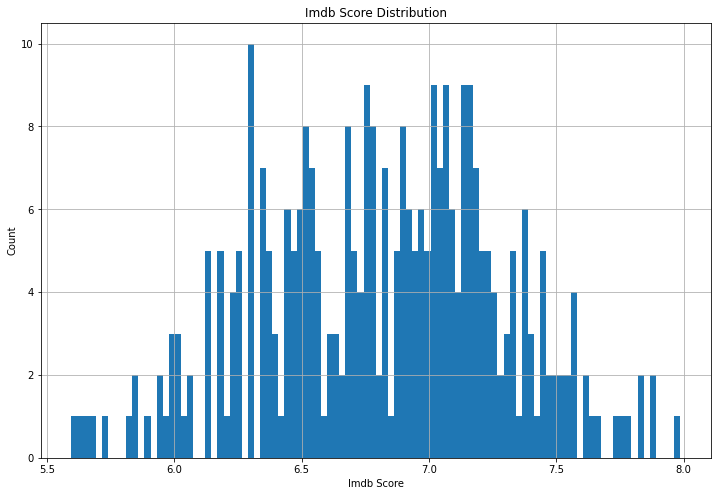

In [26]:
plot_title = 'Imdb Score Distribution'
weighted_score_plot = weighted_movies['imdb score'].plot.hist(grid=True, bins = 100, figsize=(12,8))
weighted_score_plot.set_xlabel('Imdb Score')
weighted_score_plot.set_ylabel('Count')
weighted_score_plot.set_title(plot_title)

weighted_score_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

In [27]:
# Find the top 10 films by rating 

top_score = weighted_movies.sort_values('imdb score', ascending=False)
top_score[['title', 'vote_count', 'vote_average', 'imdb score']].head(10)

,title,vote_count,vote_average,imdb score
1738,The Shawshank Redemption,8205,8.5,7.986542
642,Fight Club,9413,8.3,7.880474
65,The Dark Knight,12002,8.2,7.872603
2727,Pulp Fiction,8428,8.3,7.842619
95,Inception,13752,8.1,7.823204
2789,The Godfather,5893,8.4,7.774590
94,Interstellar,10867,8.1,7.763410
777,Forrest Gump,7927,8.2,7.744507
326,The Lord of the Rings: The Return of the King,8064,8.1,7.674001
1828,The Empire Strikes Back,5879,8.2,7.633019


# Film Finance 

This section covers the finanial data of the database covering the following:

*   Distribution of profit for movies
*   Distribution of budget for movies
*   Correlation of budget with revenue 
*   Top 20 movies interms of profit
*   Top 20 movies interms of return on investment

One consideration that should be made for the financial data is that the values may not have been adjusted for inflation.

## Distribution of Profit for each Movie

It has been assumed that the profit for each film is the revenue at time of data collection minus the production budget. It is likely that there are more costs, such as distribution but that has not been included in the data set.

All values for budget, revenue and profit are in terms of millions of dollars. 

Profit was calculated when setting up the data set and is defined as:

$profit = revenue - budget$

In [28]:
# Plot histogram of profit

min_profit = movies['profit'].min()
max_profit = movies['profit'].max()
mode_profit = movies['profit'].mode()[0]

print('Min Profit = ' + str(min_profit))
print('Max Profit = ' + str(max_profit))
print('Mode Profit = ' + str(mode_profit))


#profit_plot.set_xscale('log')

Min Profit = -165.71008999999998
Max Profit = 2550.965087
Mode Profit = 2.0


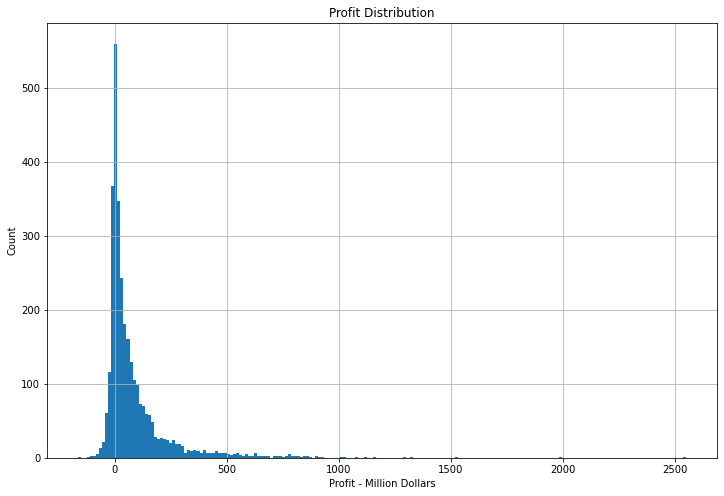

In [29]:
plot_title = 'Profit Distribution'
profit_plot = movies['profit'].plot.hist(grid=True, bins = 200, figsize=(12,8))
profit_plot.set_xlabel('Profit - Million Dollars')
profit_plot.set_ylabel('Count')
profit_plot.set_title(plot_title)

profit_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

There is a significant number of films which have zero profit. This means that there hasn't been any budget cost but also no revenue generated. It is difficult to know if these are movies with incomplete data or have been made for the art and money wasn't a consideration. 

One thing that is of signifance when considering a movie as an investment is that there is the possibilty for the film to be loss making. This risk should be considered by a investor. 

## Distribution of Budget for each Movie

In [30]:
min_budget = movies['budget'].min()
max_budget = movies['budget'].max()
mode_budget = movies['budget'].mode()[0]

print('Min Budget = ' + str(min_budget))
print('Max Budget = ' + str(max_budget))
print('Mode Budget = ' + str(mode_budget))

Min Budget = 0.007
Max Budget = 380.0
Mode Budget = 20.0


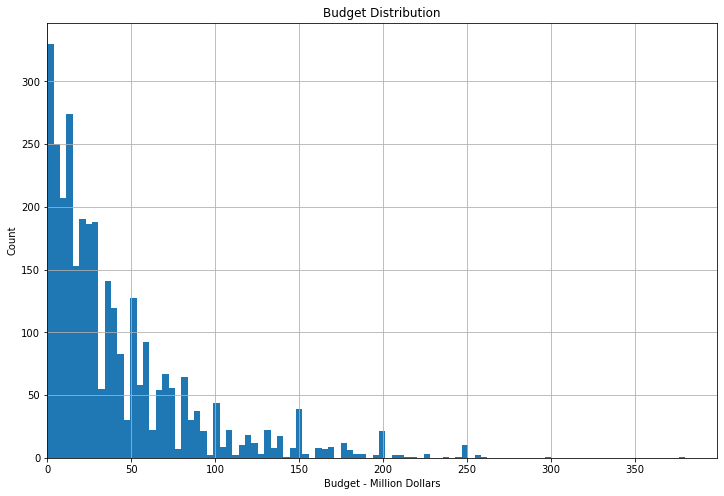

In [31]:

plot_title = 'Budget Distribution'
budget_plot = movies['budget'].plot.hist(grid=True, bins = 100, figsize=(12,8))
budget_plot.set_xbound(lower = 0)
budget_plot.set_xlabel('Budget - Million Dollars')
budget_plot.set_ylabel('Count')
budget_plot.set_title(plot_title)

budget_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

## Correlation of Budget with Revenue for Movies

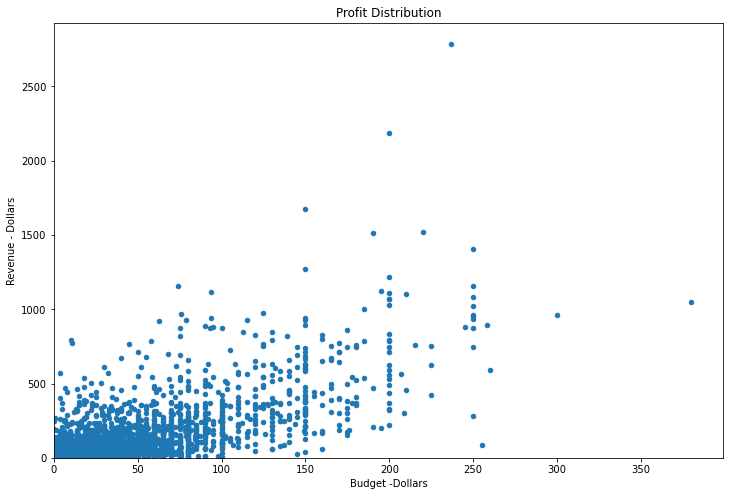

In [32]:
budget_revenue_plot = movies.plot(kind='scatter', x='budget',y='revenue',figsize=(12,8))
budget_revenue_plot.set_ybound(lower=0)
budget_revenue_plot.set_xbound(lower=0)

plot_title = 'Profit Distribution'
budget_revenue_plot.set_xlabel('Budget -Dollars')
budget_revenue_plot.set_ylabel('Revenue - Dollars')
budget_revenue_plot.set_title(plot_title)

budget_revenue_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

It is clear to see that the budget has been recorded as discrete value and is not a continuous set. 

## Identify films with largest profit margins

Sometimes it is useful to view the data to see notable cases in the dataset. 

Looking at the table below we can see that all of the films shown can be considered blockbusters and demonstrates good filtering of the data.

In [33]:
movies['ROI'] = movies['profit']/movies['budget']
movies['ROI'] = movies.ROI.round(2)

top_profit = movies.sort_values('profit', ascending=False)
top_profit['budget'] = top_profit['budget']

# Calculate ROI for top 20 profit movies

top_profit['ROI'] = top_profit['profit']/top_profit['budget']
top_profit['ROI'] = top_profit.ROI.round(2)
top_profit[['title', 'profit','budget','ROI']].head(10)

,title,profit,budget,ROI
0,Avatar,2550.965087,237.0,10.76
25,Titanic,1987.463944,200.0,9.94
28,Jurassic World,1521.713208,150.0,10.14
44,Furious 7,1325.047671,190.0,6.97
16,The Avengers,1298.815515,220.0,5.90
7,Avengers: Age of Ultron,1155.403694,250.0,4.62
123,Frozen,1124.219009,150.0,7.49
530,Minions,1082.730962,74.0,14.63
326,The Lord of the Rings: The Return of the King,1024.888979,94.0,10.90
31,Iron Man 3,1014.811252,200.0,5.07


## Identify flims with highest return on investment (ROI)

Films that were made for free with no budget were dropped from this comparision because any profit generated with give and infinite ROI. 

From an investors point of view it beneficial to maximise the ROI. One factor to consider when looking at the table below is the release date. Therefore, the time in which the investor would like to see a suitable return on investment should be considered. 



In [34]:
top_ROI = top_profit.sort_values('ROI', ascending=False)

top_ROI[['title', 'profit','budget','ROI','release_date']].head(10)

,title,profit,budget,ROI,release_date
3394,Paranormal Activity,193.340800,0.015,12889.39,2007-09-14
3373,The Blair Witch Project,248.579099,0.060,4142.98,1999-07-14
3443,Eraserhead,6.990000,0.010,699.00,1977-03-19
3452,Pink Flamingos,5.988000,0.012,499.00,1972-03-12
3445,Super Size Me,28.510078,0.065,438.62,2004-01-17
3442,The Gallows,42.564410,0.100,425.64,2015-07-10
3379,Open Water,54.537954,0.130,419.52,2004-08-06
2682,The Texas Chain Saw Massacre,30.774000,0.085,362.05,1974-10-01
3354,Bambi,266.589150,0.858,310.71,1942-08-14
3423,The Stewardesses,26.900000,0.100,269.00,1969-07-25


# Investigating Variables which can effect Profit 

*  Relation of Profit with Genre
*  Median Profit per Genre
*  View Profit Trends from the Year 2000
*  Directors which generate highest profit
*  Lead Actors which generate highest profit

## Relation of Profit with Genre

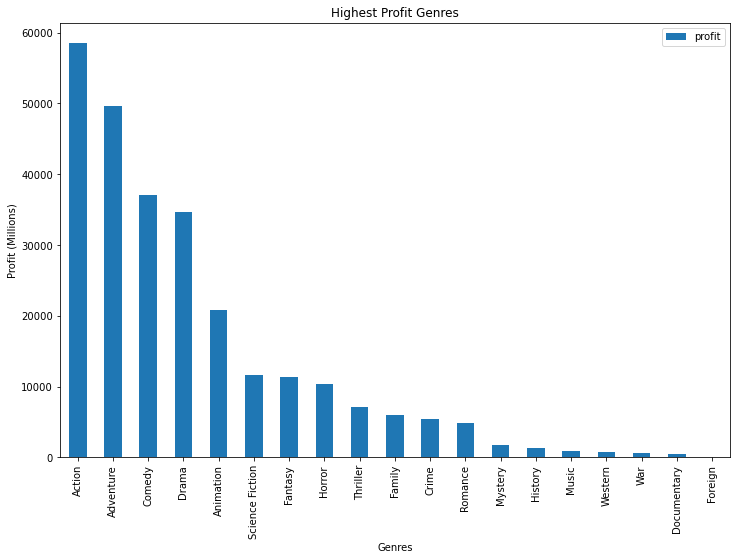

In [35]:
profit_genre = movies.groupby('primary genre').sum()['profit'].reset_index() 

profit_genre = profit_genre.sort_values('profit', ascending=False)

profit_genre_plt = profit_genre.plot(kind='bar',x='primary genre',y='profit',figsize=(12,8))

plot_title = 'Highest Profit Genres'
profit_genre_plt.set_xlabel('Genres')
profit_genre_plt.set_ylabel('Profit (Millions)')
profit_genre_plt.set_title(plot_title)
profit_genre_plt.set_ybound(lower=0)

profit_genre_plt.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

## Mean Profit per Genre

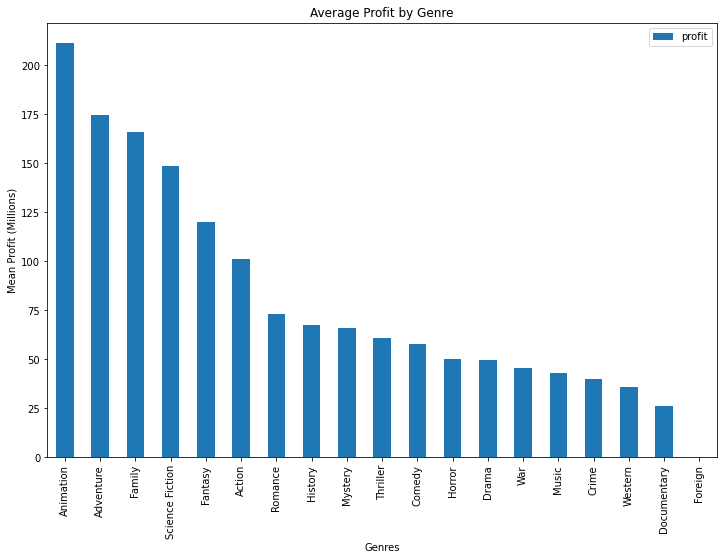

In [36]:
profit_genre_plt = movies.groupby('primary genre').mean()['profit'].reset_index().sort_values('profit', ascending=False).plot(kind='bar',x='primary genre',y='profit',figsize=(12,8))

plot_title = 'Average Profit by Genre'
profit_genre_plt.set_xlabel('Genres')
profit_genre_plt.set_ylabel('Mean Profit (Millions)')
profit_genre_plt.set_title(plot_title)
profit_genre_plt.set_ybound(lower=0)

profit_genre_plt.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

## Mean Budget per Genre


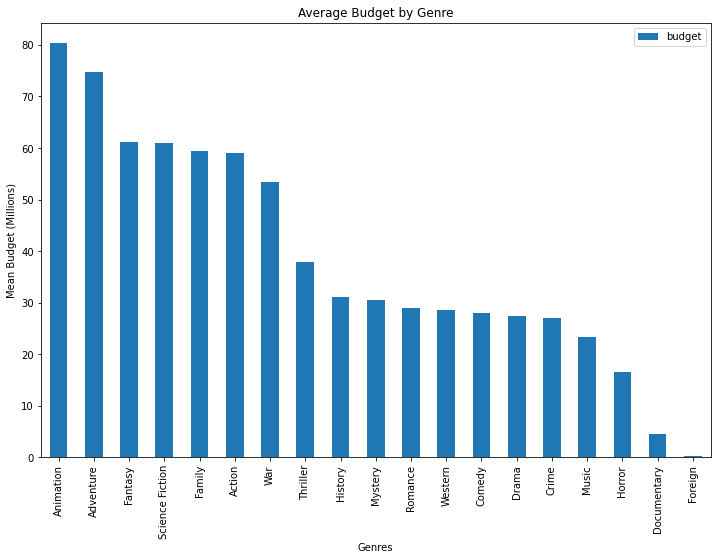

In [37]:
profit_genre_plt = movies.groupby('primary genre').mean()['budget'].reset_index().sort_values('budget', ascending=False).plot(kind='bar',x='primary genre',y='budget',figsize=(12,8))

plot_title = 'Average Budget by Genre'
profit_genre_plt.set_xlabel('Genres')
profit_genre_plt.set_ylabel('Mean Budget (Millions)')
profit_genre_plt.set_title(plot_title)
profit_genre_plt.set_ybound(lower=0)

profit_genre_plt.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

## Correleation between Primary Genre and Profit since the year 2000


In [38]:
# Create cut of data as variable datetime 

cut_off_date = datetime.datetime(2000, 1, 1)

# Cut movies dataframe down to films released after Jan 200
movies_post_2k = movies.copy().loc[movies['release_date'] > cut_off_date]

# Add df columns for release month and year 
movies_post_2k['year'] = pd.DatetimeIndex(movies_post_2k['release_date']).year
movies_post_2k['month'] = pd.DatetimeIndex(movies_post_2k['release_date']).month

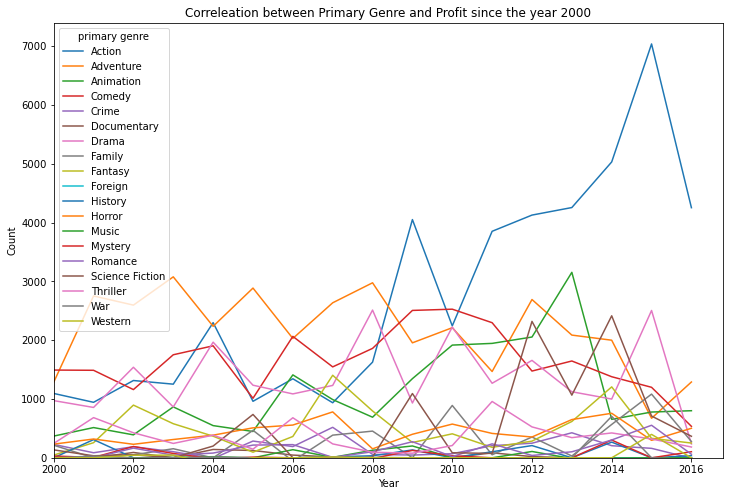

In [39]:
movies_post_2k_year = movies_post_2k.groupby(['year','primary genre']).sum()['profit']
movies_post_2k_year = movies_post_2k_year.unstack().replace(np.NaN,0)

plot_title = 'Correleation between Primary Genre and Profit since the year 2000'
fig, ax = plt.subplots(figsize=(12,8))
movies_post_2k_year_plot = movies_post_2k_year.plot(ax=ax)
movies_post_2k_year_plot.set_xbound(lower=2000)
movies_post_2k_year_plot.set_ybound(lower=0)
movies_post_2k_year_plot.set_xlabel('Year')
movies_post_2k_year_plot.set_ylabel('Count')
movies_post_2k_year_plot.set_title(plot_title)

movies_post_2k_year_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

### Bar Plot of Revenue Variation each Year since 2000

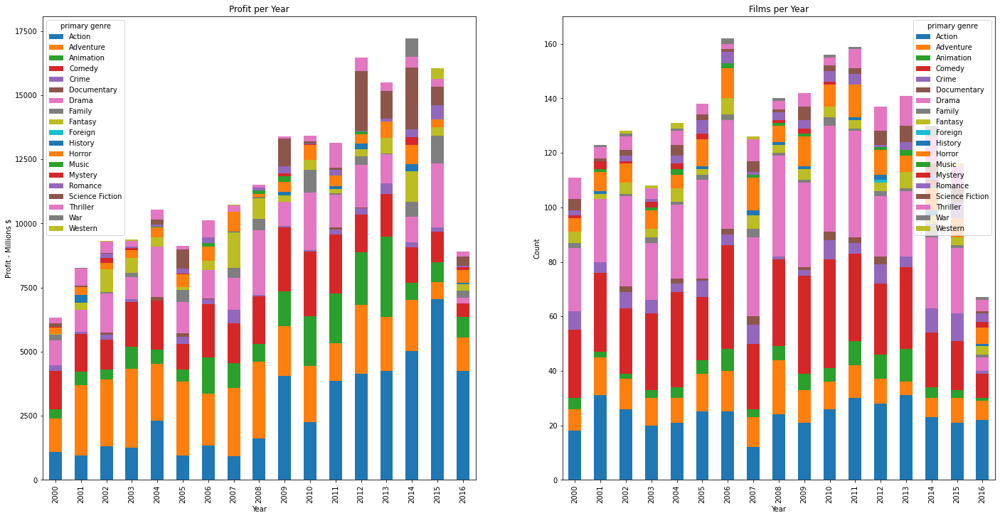

In [40]:
fig, (ax1, ax2) = plt.subplots(1,2)

movies_post_2k_year.plot(kind='bar',stacked=True,figsize=(24,12), ax = ax1)
movies_post_2k_year_count = movies_post_2k.groupby(['year','primary genre']).count()['id'].unstack()
movies_post_2k_year_count.plot(kind='bar',stacked=True,figsize=(24,12), ax = ax2)

plot_title = 'Breakdown per Year'
ax1.set_title('Profit per Year')
ax1.set_ylabel('Profit - Millions $')
ax1.set_xlabel('Year')
ax1.set_ybound(lower=0)
ax2.set_title('Films per Year')
ax2.set_ylabel('Count')
ax2.set_xlabel('Year')

fig.savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

### Bar Plot of Revenue Variation each Month since 2000

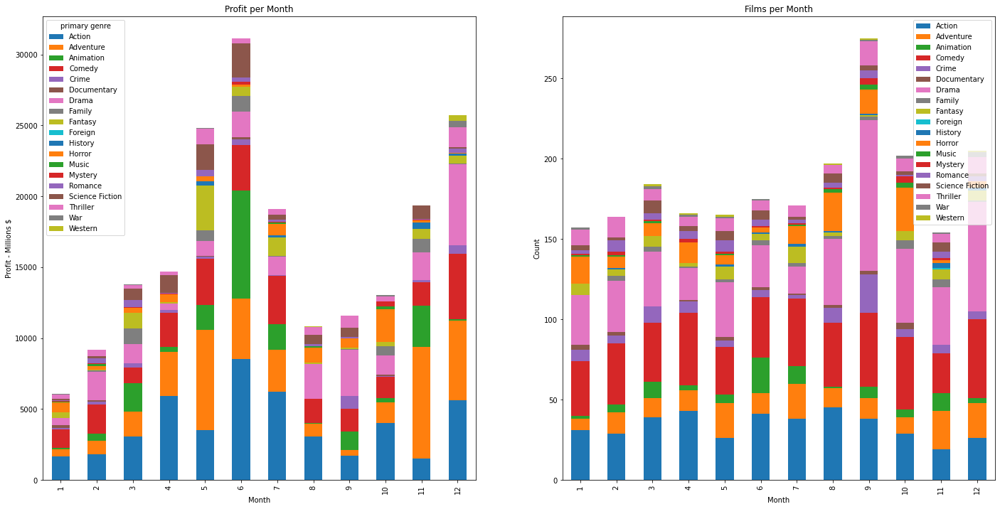

In [43]:
# Group data by month

movies_post_2k_month = movies_post_2k.groupby(['month','primary genre']).sum()['profit'].unstack()
movies_post_2k_month_count = movies_post_2k.groupby(['month','primary genre']).count()['id'].unstack()

# Plot graphs 

fig, (ax1, ax2) = plt.subplots(1,2)
movies_post_2k_month.plot(kind='bar',stacked=True,figsize=(24,12),ax=ax1)
movies_post_2k_month_count.plot(kind='bar',stacked=True,figsize=(24,12),ax=ax2)

plot_title = ('Profit-Films Per Month')
ax1.set_title('Profit per Month')
ax1.set_ylabel('Profit - Millions $')
ax1.set_xlabel('Month')
ax1.set_ybound(lower=0)
ax2.set_title('Films per Month')
ax2.set_ylabel('Count')
ax2.set_xlabel('Month')
ax2.legend(loc='upper right')

fig.savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

### Bar Plot of Revenue Variation each Year since 2000 for Imdb rated movies

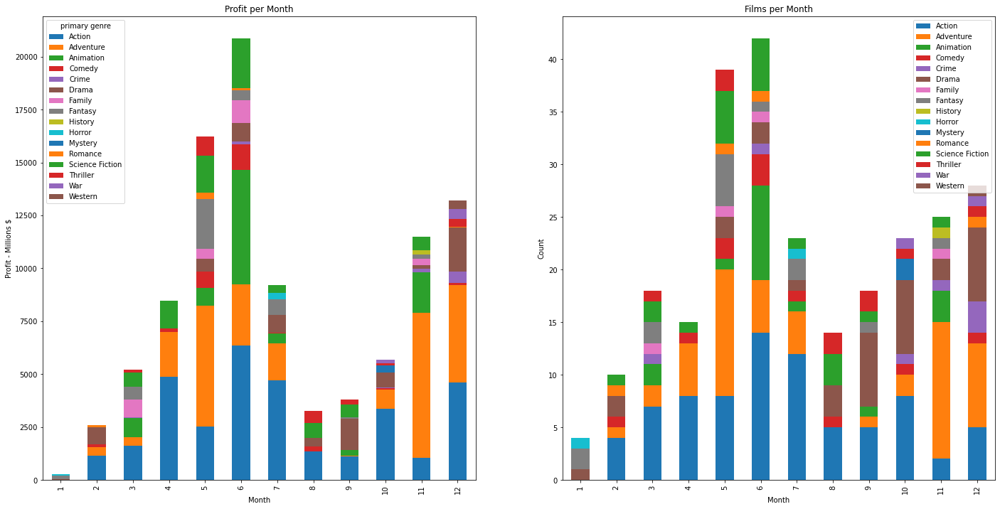

In [44]:
weighted_movies_post_2k = weighted_movies.copy().loc[weighted_movies['release_date'] > cut_off_date]
weighted_movies_post_2k['year'] = pd.DatetimeIndex(weighted_movies_post_2k['release_date']).year
weighted_movies_post_2k['month'] = pd.DatetimeIndex(weighted_movies_post_2k['release_date']).month
#weighted_movies_post_2k['profit'] = weighted_movies_post_2k['revenue'] - weighted_movies_post_2k['budget']

weighted_movies_post_2k_month = weighted_movies_post_2k.groupby(['month','primary genre']).sum()['profit']
#weighted_movies_post_2k_grouped  = weighted_movies_post_2k_grouped.sort_values(by = ['year', 'profit'], ascending=[True,False])
weighted_movies_post_2k_month = weighted_movies_post_2k_month.unstack().replace(np.NaN,0)
weighted_movies_post_2k_month_count = weighted_movies_post_2k.groupby(['month','primary genre']).count()['id'].unstack()

fig, (ax1, ax2) = plt.subplots(1,2)

weighted_movies_post_2k_month.plot(kind='bar',stacked=True,figsize=(24,12),ax=ax1)
weighted_movies_post_2k_month_count.plot(kind='bar',stacked=True,figsize=(24,12),ax=ax2)

plot_title = 'Profit Breakdown'
ax1.set_title('Profit per Month')
ax1.set_ylabel('Profit - Millions $')
ax1.set_xlabel('Month')
ax1.set_ybound(lower=0)
ax2.set_title('Films per Month')
ax2.set_ylabel('Count')
ax2.set_xlabel('Month')
ax2.legend(loc='upper right')

fig.savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

From these plots it can be seen that for movies with an Imdb rating there are certain point in the year when movies are to be released which correlates with larger profits in those months. 

For films without an Imdb rating the rate of release is fairly even through out the year. 

## Directors who have generated the highest cumulative profit since the year 2000

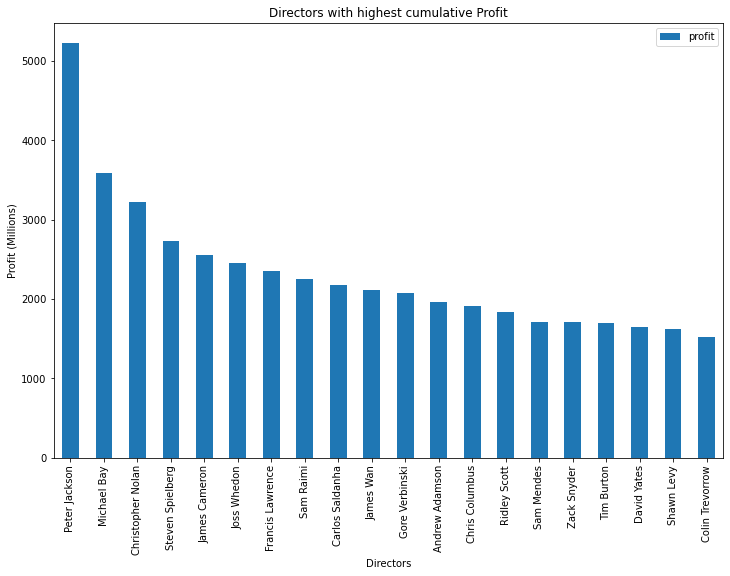

In [45]:
top_directors = movies_post_2k.groupby(['director']).sum()['profit'].reset_index()

top_directors = top_directors.sort_values('profit', ascending=False)

top_directors_plot = top_directors.head(20).plot(kind='bar',x = 'director', y = 'profit', figsize=(12,8))

plot_title = 'Directors with highest cumulative Profit'
top_directors_plot.set_xlabel('Directors')
top_directors_plot.set_ylabel('Profit (Millions)')
top_directors_plot.set_title(plot_title)
top_directors_plot.set_ybound(lower=0)

top_directors_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')


## Lead Actors who generate highest cumulative profit since the year 2000

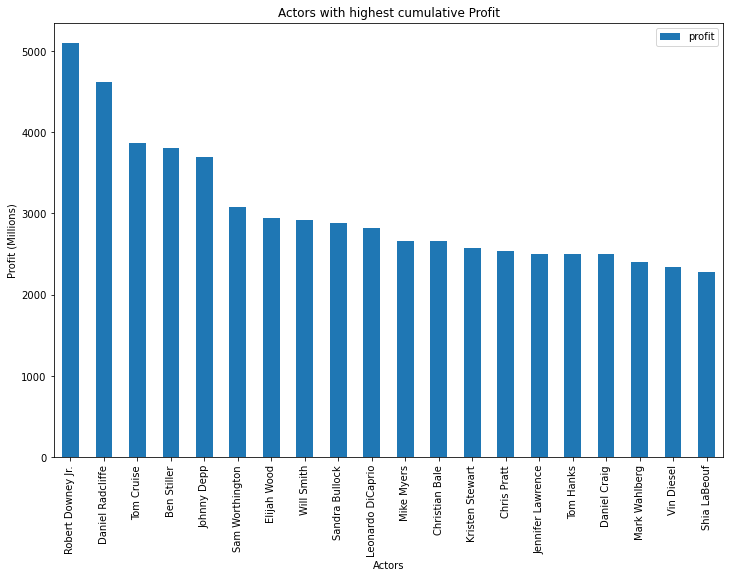

In [46]:
top_actors = movies_post_2k.groupby(['lead actor']).sum()['profit'].reset_index()

top_actors = top_actors.sort_values('profit', ascending=False)

top_actors_plot = top_actors.head(20).plot(kind='bar',x = 'lead actor', y = 'profit', figsize=(12,8))

plot_title = 'Actors with highest cumulative Profit'
top_actors_plot.set_xlabel('Actors')
top_actors_plot.set_ylabel('Profit (Millions)')
top_actors_plot.set_title(plot_title)
top_actors_plot.set_ybound(lower=0)

top_actors_plot.get_figure().savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

# Correlation Analysis 

A preliminary step of regressional modelling is to view the correlations between the numerical variables availible. 

Two different methods have been performed to carry this out. The first is a grid plot of all variables against each other. The latter is the calculation of the Pearson's Coefficient which is visulaised through a heat map.

## Visual view of correlation between numberic variables

In [47]:
movies_numeric = movies[['budget', 'popularity', 'release_date','revenue','runtime', 'vote_average','vote_count','profit']] # this should use the imdb weighting not the voting average

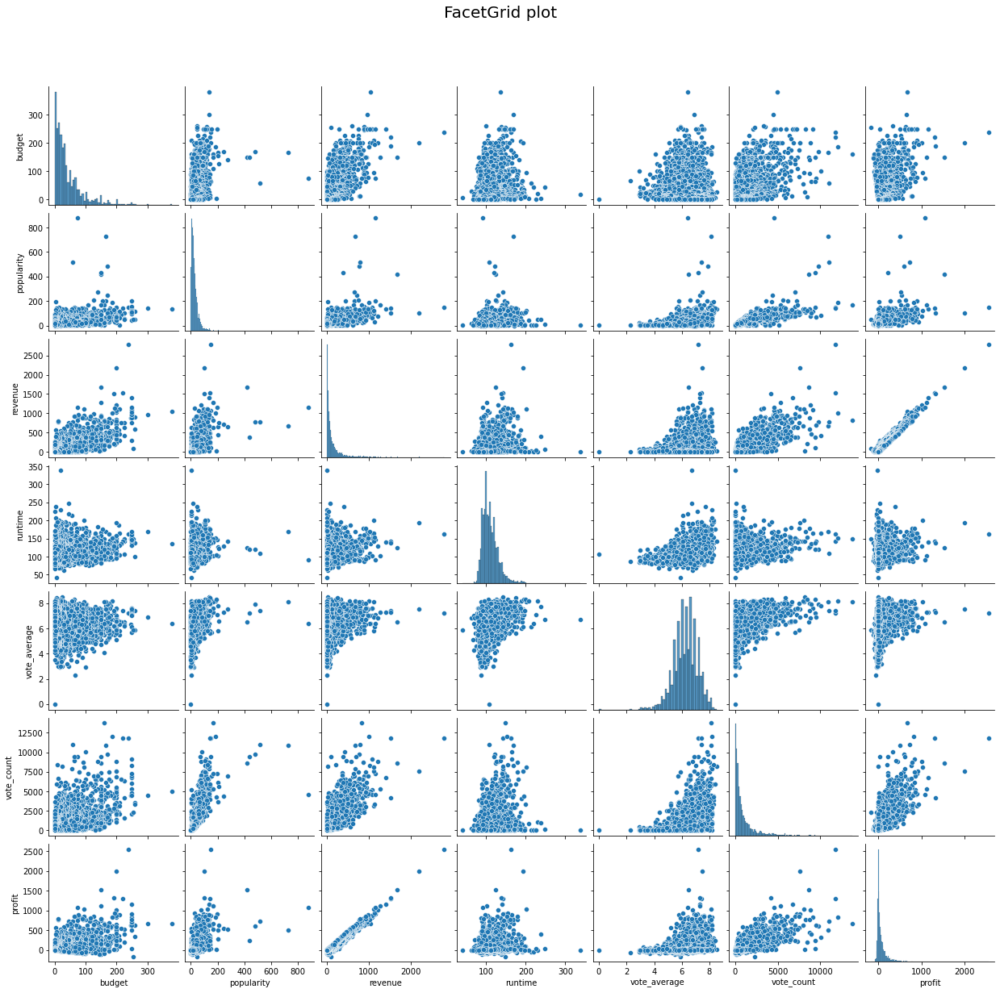

In [48]:
plot_title = 'FacetGrid plot'
movies_numeric_plot = sns.pairplot(movies_numeric)
movies_numeric_plot.fig.suptitle(plot_title, fontsize = 20)
movies_numeric_plot.fig.subplots_adjust(top= 0.9);

movies_numeric_plot.fig.savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

## Correlation Analysis with Pearson's correlation coefficient
This is an important step prior to regression analysis. Reason being that one of the assumptions of linear regression is the absence of multi-collinearity. Highly correlated regressors (predictors) overstep this condition, which results in amplified regression coefficients.

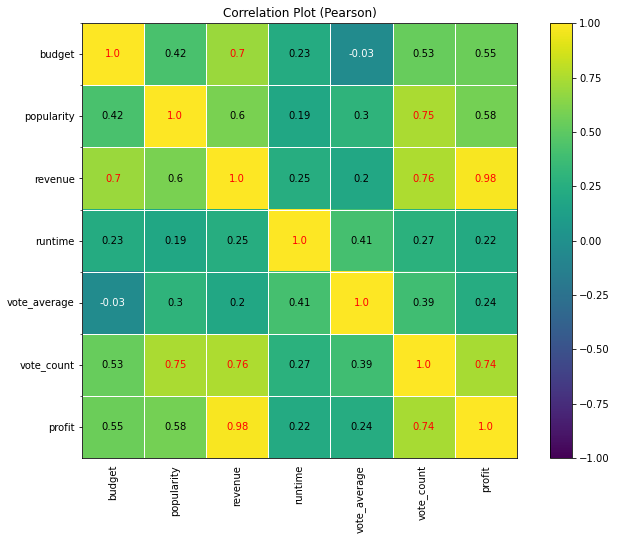

In [49]:
numCols = movies_numeric.select_dtypes(include=['float64', 'int64']).columns
corrMat = movies_numeric[numCols].corr(method='pearson') # PEARSON

plt.figure(num=9, figsize=(12,8))
plt.matshow(corrMat, fignum=False, vmin=-1, vmax=1, cmap='viridis')

# Text annotation
for i in range(len(numCols)):
    for j in range(len(numCols)):
        if corrMat.iloc[i, j] < 0:
            plt.text(i, j, round(corrMat.iloc[i, j], 2), ha="center", va="center", color="w")
        elif corrMat.iloc[i, j] > 0.7:
            plt.text(i, j, round(corrMat.iloc[i, j], 2), ha="center", va="center", color="red")
        else:
            plt.text(i, j, round(corrMat.iloc[i, j], 2), ha="center", va="center", color="black")           

plt.xticks(range(len(numCols)), numCols, rotation=90)
plt.yticks(range(len(numCols)), numCols)
plt.tick_params(axis='x', labelbottom=True, labeltop=False, top=False, bottom=False)

ax = plt.gca()
ax.set_xticks(np.arange(len(numCols))-.5, minor=True)
ax.set_yticks(np.arange(len(numCols))-.5, minor=True)

plt.tick_params(axis='x', which='both', labelbottom=True, labeltop=False, top=False, bottom=False)

plot_title = 'Correlation Plot (Pearson)'
plt.grid(which='minor', color='w', linestyle='-', linewidth=1)
plt.grid(False)
plt.title(plot_title)
plt.colorbar();

plt.savefig('Figures/' + plot_title + '.png',dpi=400,bbox_inches='tight')

# Conclusions

At the top level there aren't any clear correlations between variables which give a clear indication of the profit for a film. However, through applying an Imdb rating to the films some trends can be identified. 

For films that have had enough reviews to be counted by the imdb algorithm films with the primary genre as action released in the summer have had the largest profits since the year 2000. 

Since the year 2000 the actor Peter Jackson has the largest profits for their work. Robert Dowey Jr. and Daniel Radcliff have produced the largetst profits. Possibly from their francies of Ironman and Harry Potter. 

# Summary

*  A extraction of the data was performed to allow simpler access to the data.
*  A scrapper was created to try to improve data quality.  
*  The data was cleaned to remove obvious erroneous data.
*  The data was broken down to determine the frequency of characteristics such as genres.
*  An investigation was performed to identify the effect of different variables on the profit generated for a film
*  Correlative analysis was carried out to develop a strategy developing suitable models to predict profit.